I´m going to use CRISP-DM methology to develop this test

## import libraries

In [413]:
import pandas as pd
import matplotlib as plt
import seaborn as sns
import plotly.express as px


# Data acquisition

In [414]:
df = pd.read_excel('Base_proyecto.xlsx')

In [415]:
pd.options.display.max_columns = None

In [416]:
df.head(3)

,ID,Tipo poliza,Valor Asegurado,Fecha Emisión,Fecha Inicio,Fecha fin,Valor prima Anual,Valor asegurado Vhiculo,Ciudad,DEPARTAMENTO,OCUPACION,EDAD,MARCA/TIPO (CODIGO FASECOLDA),MARCA,REF1,REF2,REF3,CLASE,Modelo del Vehiculo,COLOR,Años de no reclamación,GENERO,DEDUCIBLES
0,1,Renovacion,684689000,2011-10-10,2011-11-21,2012-11-21,782949.0,18800000,CARTAGENA,BOLIVAR,EMPLEADO(A),45,CHEVROLET AVEO FAMILY MT 1500C,CHEVROLET,AVEO,FAMILY,MT 1500CC 4P AA,AUTOMOVIL,2010.0,NEGRO EBONY,DOS AÑOS CONTINUOS,MASCULINO,10% del Valor de Reclamación Mínimo 1 SMMLV
1,2,Nuevo,965205600,2011-10-10,2011-10-05,2012-10-05,715824.0,24900000,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),41,CHEVROLET AVEO EMOTION 1.6L MT,CHEVROLET,AVEO EMOTION,1.6L,MT 1600CC AA 2AB ABS,AUTOMOVIL,2009.0,BLANCO ARCO BICAPA,CUATRO O MAS AÑOS,MASCULINO,10% del Valor de Reclamación Mínimo 1 SMMLV
2,3,Nuevo,640605600,2011-10-10,2011-10-03,2012-10-03,740816.0,12600000,MEDELLIN,ANTIOQUIA,INDEPENDIENTE,33,RENAULT CLIO II F.II EXPRESSIO,RENAULT,CLIO II,F.II EXPRESSION,MT 1400CC PACK,AUTOMOVIL,2002.0,BEIGE CARRARA,TRES AÑOS CONTINUOS,FEMENINO,10% del Valor de Reclamación Mínimo 1 SMMLV


In [417]:
# Lets take a look at the Dataset in general
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 120930 entries, 0 to 120929
Data columns (total 23 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   ID                             120930 non-null  int64         
 1   Tipo poliza                    120930 non-null  object        
 2   Valor Asegurado                120930 non-null  int64         
 3   Fecha Emisión                  120930 non-null  datetime64[ns]
 4   Fecha Inicio                   120930 non-null  datetime64[ns]
 5   Fecha fin                      120930 non-null  datetime64[ns]
 6   Valor prima Anual              120930 non-null  float64       
 7   Valor asegurado Vhiculo        120930 non-null  int64         
 8   Ciudad                         120640 non-null  object        
 9   DEPARTAMENTO                   120627 non-null  object        
 10  OCUPACION                      120930 non-null  object        
 11  

In [418]:
df.describe()

,ID,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo,Modelo del Vehiculo
count,120930.000000,1.209300e+05,1.209300e+05,1.209300e+05,120802.000000
mean,60534.659638,2.135668e+09,5.743645e+05,3.226011e+07,2009.879663
std,34933.903444,9.395444e+08,5.113837e+05,1.920124e+07,3.397206
min,1.000000,1.731979e+08,-2.331607e+06,2.880000e+04,1990.000000
25%,30287.250000,1.271938e+09,1.801246e+05,1.940000e+07,2008.000000
50%,60534.500000,2.173003e+09,5.062709e+05,2.799000e+07,2011.000000
75%,90789.750000,3.068693e+09,8.201882e+05,4.020000e+07,2013.000000
max,121039.000000,6.345327e+09,1.089682e+07,4.320000e+08,2014.000000


1. We could see that there are negative values in Col "Valor prima Anual" 
2. Some columns that need to be on category type
3. Some High Standar D. 

# DATA PREPARATION

# 1. Data integration

There are no more data integration to join. I have only the .xlsx file

# 2. IRELEVANT VARIABLES

# 2.1 IrrelevantCols: Lets check for each column how many percentage of unique values have, and if its unique values are the 100%

In [419]:
df.columns

Index(['ID', 'Tipo poliza', 'Valor Asegurado', 'Fecha Emisión ',
       'Fecha Inicio', 'Fecha fin', 'Valor prima Anual',
       'Valor asegurado Vhiculo', 'Ciudad', 'DEPARTAMENTO', 'OCUPACION',
       'EDAD', 'MARCA/TIPO (CODIGO FASECOLDA)', 'MARCA', 'REF1', 'REF2',
       'REF3', 'CLASE', 'Modelo del Vehiculo', 'COLOR',
       'Años de no reclamación', 'GENERO', 'DEDUCIBLES'],
      dtype='object')

In [420]:
len(df['ID'].unique())
df['ID'].count()

120930

In [421]:
for i in df.columns:
    print((len(df[i].unique()) / df[i].count())*100, i)

100.0 ID
0.0024807740014884646 Tipo poliza
32.43198544612586 Valor Asegurado
0.5689241710080212 Fecha Emisión 
0.6830397750764905 Fecha Inicio
0.9286364012238485 Fecha fin
72.57173571487637 Valor prima Anual
4.9268171669560905 Valor asegurado Vhiculo
0.4990053050397878 Ciudad
0.026528057565884916 DEPARTAMENTO
0.004134623335814107 OCUPACION
0.07139326706573672 EDAD
1.8101530650216242 MARCA/TIPO (CODIGO FASECOLDA)
0.05209625403125775 MARCA
0.7144629124286778 REF1
0.9823504089539389 REF2
1.125269048643995 REF3
0.004134623335814107 CLASE
0.019867220741378457 Modelo del Vehiculo
2.1861269476140435 COLOR
0.007957770763150216 Años de no reclamación
0.0024807740014884646 GENERO
0.150093808630394 DEDUCIBLES


In [422]:
for i in df.columns:
    print('------------------', i, '------------------' )
    percentage = df[i].value_counts()/df[i].count()*100
    
    print(percentage)

------------------ ID ------------------
2047      0.000827
21792     0.000827
77071     0.000827
120080    0.000827
115986    0.000827
            ...   
60104     0.000827
58057     0.000827
64202     0.000827
62155     0.000827
2049      0.000827
Name: ID, Length: 120930, dtype: float64
------------------ Tipo poliza ------------------
Nuevo           65.154221
Renovacion      22.441082
Modificación    12.404697
Name: Tipo poliza, dtype: float64
------------------ Valor Asegurado ------------------
3096819013    0.114943
3065839013    0.111635
3072839013    0.109981
3080839013    0.108327
3069294663    0.107500
                ...   
3176097882    0.000827
1305629013    0.000827
362389013     0.000827
3088724313    0.000827
3073381882    0.000827
Name: Valor Asegurado, Length: 39220, dtype: float64
------------------ Fecha Emisión  ------------------
2012-09-18    1.782023
2012-05-27    1.495080
2012-09-19    1.180022
2012-09-15    1.028694
2012-09-23    0.712809
                ...

In [423]:
# I´m going to delete the ID column, and with the date columns maybe later,
# because with those I could create some new features that could help to improve the model
cols_to_drop = ['ID']

In [424]:
# Let´s drop codigo fasecolda too, becaus the values are in the next 3 variables
cols_to_drop2 = ['MARCA/TIPO (CODIGO FASECOLDA)']

In [425]:
df.drop(cols_to_drop, axis=1, inplace=True)
df.drop(cols_to_drop2, axis=1, inplace=True)

In [426]:
df.head(2)

,Tipo poliza,Valor Asegurado,Fecha Emisión,Fecha Inicio,Fecha fin,Valor prima Anual,Valor asegurado Vhiculo,Ciudad,DEPARTAMENTO,OCUPACION,EDAD,MARCA,REF1,REF2,REF3,CLASE,Modelo del Vehiculo,COLOR,Años de no reclamación,GENERO,DEDUCIBLES
0,Renovacion,684689000,2011-10-10,2011-11-21,2012-11-21,782949.0,18800000,CARTAGENA,BOLIVAR,EMPLEADO(A),45,CHEVROLET,AVEO,FAMILY,MT 1500CC 4P AA,AUTOMOVIL,2010.0,NEGRO EBONY,DOS AÑOS CONTINUOS,MASCULINO,10% del Valor de Reclamación Mínimo 1 SMMLV
1,Nuevo,965205600,2011-10-10,2011-10-05,2012-10-05,715824.0,24900000,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),41,CHEVROLET,AVEO EMOTION,1.6L,MT 1600CC AA 2AB ABS,AUTOMOVIL,2009.0,BLANCO ARCO BICAPA,CUATRO O MAS AÑOS,MASCULINO,10% del Valor de Reclamación Mínimo 1 SMMLV


# 2.2 Duplicated rows

In [427]:
df.duplicated(keep='first').sum()

105

In [428]:
df.loc[df.duplicated(), :]

,Tipo poliza,Valor Asegurado,Fecha Emisión,Fecha Inicio,Fecha fin,Valor prima Anual,Valor asegurado Vhiculo,Ciudad,DEPARTAMENTO,OCUPACION,EDAD,MARCA,REF1,REF2,REF3,CLASE,Modelo del Vehiculo,COLOR,Años de no reclamación,GENERO,DEDUCIBLES
513,Renovacion,1274862600,2011-10-31,2011-10-30,2011-11-30,3.557333e+03,16600000,BOGOTA D.C.,CUNDINAMARCA,PERSONA JURIDICA,26,RENAULT,LOGAN,ENTRY [FAMILIER],MT 1400CC SA,AUTOMOVIL,2009.0,BLANCO ARTICA,DOS AÑOS CONTINUOS,PERSONA JURIDICA,10% del Valor de Reclamación Mínimo 1 SMMLV
2147,Renovacion,1398189000,2011-12-03,2011-12-13,2012-12-13,1.016306e+06,50300000,BARRANQUILLA,ATLANTICO,INDEPENDIENTE,49,NISSAN,D22 FRONTIER,AX,MT 3000CC 4X4 TD FE RIN,PICKUP DOBLE CAB,2010.0,BLANCO,DOS AÑOS CONTINUOS,MASCULINO,10% del Valor de Reclamación Mínimo 1 SMMLV
22518,Renovacion,757697882,2012-08-14,2012-08-30,2013-08-30,2.330806e+06,70800000,BARRANQUILLA,ATLANTICO,PERSONA JURIDICA,43,TOYOTA,HILUX [7] [FL],IMV,MT 2500CC TD 4X4 AA 2AB ABS,PICKUP DOBLE CAB,2011.0,SUPER BLANCO 2,CUATRO O MAS AÑOS,PERSONA JURIDICA,NaN
64001,Renovacion,235639013,2013-04-16,2013-04-15,2014-04-15,4.408889e+05,34400000,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),38,RENAULT,DUSTER,EXPRESSION,MT 1600CC 4X2,CAMIONETA PASAJ.,2011.0,VERDE AMAZONIA,DOS AÑOS CONTINUOS,FEMENINO,NaN
74535,Nuevo,1274839013,2013-06-16,2013-06-12,2014-06-12,3.736778e+05,26500000,ACACIAS,META,EMPLEADO(A),44,CHEVROLET,SAIL,LS,MT 1400CC 4P AA,AUTOMOVIL,2013.0,AZUL NORUEGA,MENOS DE UN AÑO,FEMENINO,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118880,Modificación,3073719013,2013-12-22,2013-12-18,2014-12-18,0.000000e+00,27990000,CALI,VALLE,EMPLEADO(A),36,KIA,RIO,STYLUS,MT 1500CC 4P AA,AUTOMOVIL,2014.0,PLATA,MENOS DE UN AÑO,FEMENINO,NaN
118999,Modificación,3133039013,2013-12-24,2013-12-23,2014-12-23,0.000000e+00,58100000,BARRANQUILLA,ATLANTICO,EMPLEADO(A),40,HYUNDAI,i35 ELANTRA,1.8L ACTIVE,MT 1800CC 1AB CT,AUTOMOVIL,2013.0,HIPERMETALICO,UN AÑO CONTINUO,MASCULINO,NaN
119070,Nuevo,2146784163,2013-12-28,2013-12-24,2014-12-24,1.881250e+04,15000000,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),NaN,RENAULT,SYMBOL,ALIZE FASE IV,MT 1400CC AA 16V,AUTOMOVIL,2007.0,GRIS,NaN,MASCULINO,NaN
119213,Modificación,3092579015,2013-12-22,2013-12-22,2014-12-10,0.000000e+00,37870001,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),50,CHEVROLET,SAIL,LTZ SPORT,MT 1400CC 5P AA 2AB ABS,AUTOMOVIL,2014.0,GRIS GALAPAGO,MENOS DE UN AÑO,MASCULINO,NaN


finally let´s delete all duplicated rows keeping the first row

In [429]:
df.drop_duplicates(keep='first',  inplace=True)

The DataFreame now has 120.825 rows (it began with 120930)

In [430]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 120825 entries, 0 to 120929
Data columns (total 21 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   Tipo poliza              120825 non-null  object        
 1   Valor Asegurado          120825 non-null  int64         
 2   Fecha Emisión            120825 non-null  datetime64[ns]
 3   Fecha Inicio             120825 non-null  datetime64[ns]
 4   Fecha fin                120825 non-null  datetime64[ns]
 5   Valor prima Anual        120825 non-null  float64       
 6   Valor asegurado Vhiculo  120825 non-null  int64         
 7   Ciudad                   120535 non-null  object        
 8   DEPARTAMENTO             120522 non-null  object        
 9   OCUPACION                120825 non-null  object        
 10  EDAD                     109163 non-null  object        
 11  MARCA                    120825 non-null  object        
 12  REF1            

# 3. STATISTICAL DESCRIPTION

In [431]:
df.describe()

,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo,Modelo del Vehiculo
count,1.208250e+05,1.208250e+05,1.208250e+05,120697.000000
mean,2.135436e+09,5.747100e+05,3.225057e+07,2009.878348
std,9.394923e+08,5.113818e+05,1.919327e+07,3.397388
min,1.731979e+08,-2.331607e+06,2.880000e+04,1990.000000
25%,1.271879e+09,1.804621e+05,1.940000e+07,2008.000000
50%,2.172953e+09,5.068577e+05,2.799000e+07,2011.000000
75%,3.068639e+09,8.204400e+05,4.020000e+07,2013.000000
max,6.345327e+09,1.089682e+07,4.320000e+08,2014.000000


1. column "Valor Asegurado" has a big std compared with its mean vale
2. column "Valor prima anual" has a negative value
3. "Modelo del Vehículo" it is a categorical variable but we could extract some new features with it being a numerical variable.

Behaviour of "Valor prima anual" , "Valor Asegurado", "Valor asegurado Vhiculo"

In [432]:
df_M = df.groupby(pd.Grouper(key="Fecha Emisión ", freq="M")).mean()
df_M.head()

,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo,Modelo del Vehiculo
Fecha Emisión,,,,
2011-10-31,9.628473e+08,9.528761e+05,3.491998e+07,2009.036624
2011-11-30,1.037908e+09,9.658780e+05,3.200237e+07,2008.109091
2011-12-31,1.338367e+09,1.101056e+06,3.070965e+07,2007.913850
2012-01-31,1.367132e+09,1.075920e+06,2.983930e+07,2008.029510
2012-02-29,1.294272e+09,1.058421e+06,2.853114e+07,2007.818878


In [433]:
px.line(df_M, y= 'Valor prima Anual')

There is a Sightly decrease between jan 2012 and jan 2013 in "Valor prima anual", after this point it begun a sharply decrease to dec 2013.

In [434]:
px.line(df_M, y= 'Valor Asegurado')

In [435]:
px.line(df_M, y= 'Valor asegurado Vhiculo')

Group by GENERO

In [436]:
df_GENERO = df.groupby('GENERO').mean()
df_GENERO

,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo,Modelo del Vehiculo
GENERO,,,,
FEMENINO,2.102653e+09,546146.581936,3.055508e+07,2009.875599
MASCULINO,2.178286e+09,605110.262752,3.375256e+07,2009.882322
PERSONA JURIDICA,2.073910e+09,712393.607848,4.876918e+07,2009.862786


In [437]:
px.bar(df_GENERO, y='Valor prima Anual')

There is over 10% cost in "Valor prima anual" on MASCULINO than FEMENINO

Categorical Data

In [438]:
cols_categorical = df.select_dtypes(include=[object]).columns
cols_categorical

Index(['Tipo poliza', 'Ciudad', 'DEPARTAMENTO', 'OCUPACION', 'EDAD', 'MARCA',
       'REF1', 'REF2', 'REF3', 'CLASE', 'COLOR', 'Años de no reclamación',
       'GENERO', 'DEDUCIBLES'],
      dtype='object')

Numerical Data

In [439]:
cols_numeric = df.select_dtypes(include=['int64', 'float64']).columns
cols_numeric

Index(['Valor Asegurado', 'Valor prima Anual', 'Valor asegurado Vhiculo',
       'Modelo del Vehiculo'],
      dtype='object')

Plotting categorical data

In [440]:
# change the "modelo vehiculo" as a categorical data
df['Modelo del Vehiculo']=df['Modelo del Vehiculo'].astype('category')

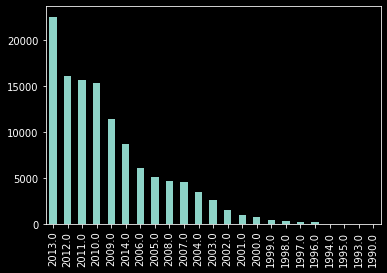

In [441]:
df['Modelo del Vehiculo'].value_counts().plot(kind='bar')

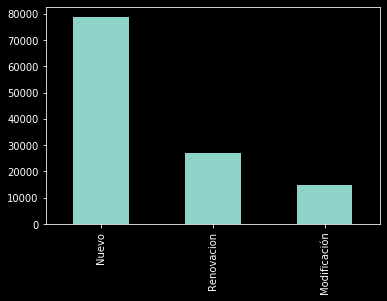

In [442]:
df['Tipo poliza'].value_counts().plot(kind='bar')

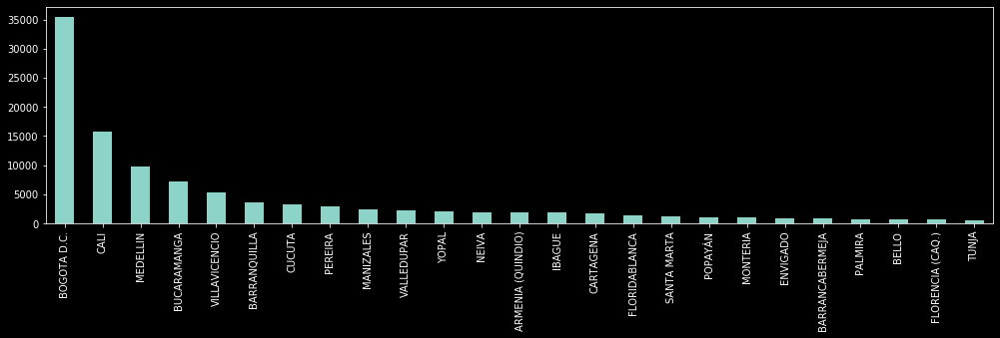

In [443]:
df['Ciudad'].value_counts()[:25].plot(figsize=(17,4), kind='bar')

TO FIX: Aparentrly there are two columns that are shifted related to their city. Ex: norte de santander and atlantico are shifted with their respective cities

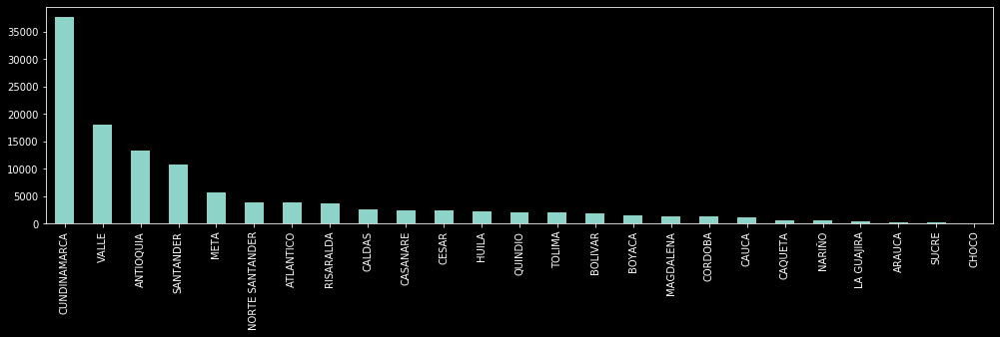

In [444]:
df['DEPARTAMENTO'].value_counts()[:25].plot(figsize=(17,4), kind='bar')

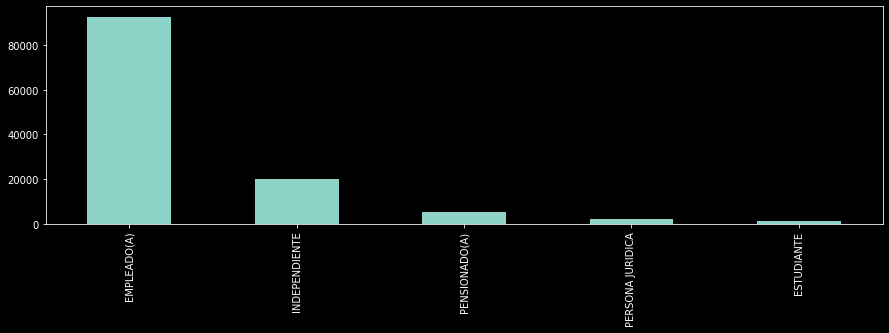

In [445]:
df['OCUPACION'].value_counts().plot(figsize=(15,4), kind='bar')

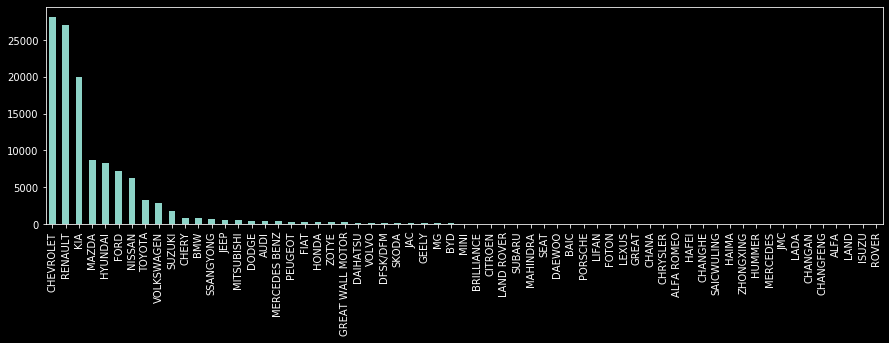

In [447]:
df['MARCA'].value_counts().plot(figsize=(15,4), kind='bar')

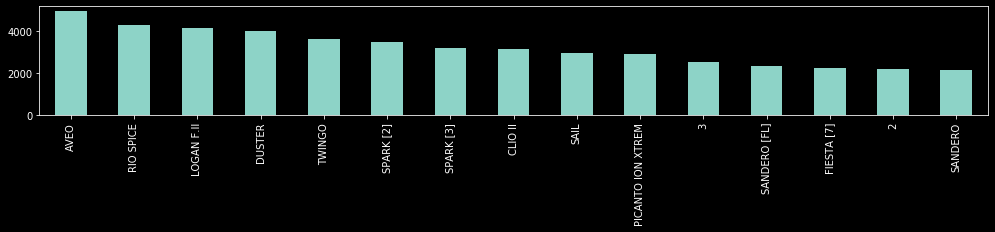

In [448]:
df['REF1'].value_counts()[:15].plot(figsize=(17,2), kind='bar')

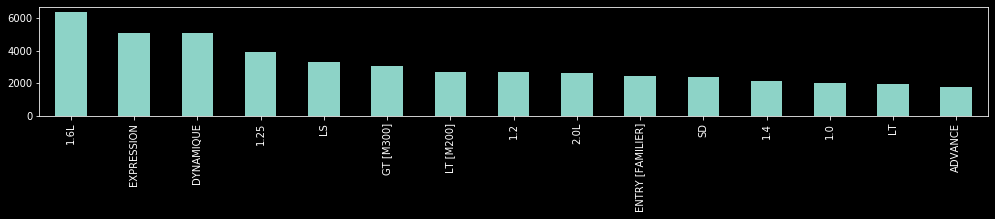

In [449]:
df['REF2'].value_counts()[:15].plot(figsize=(17,2), kind='bar')

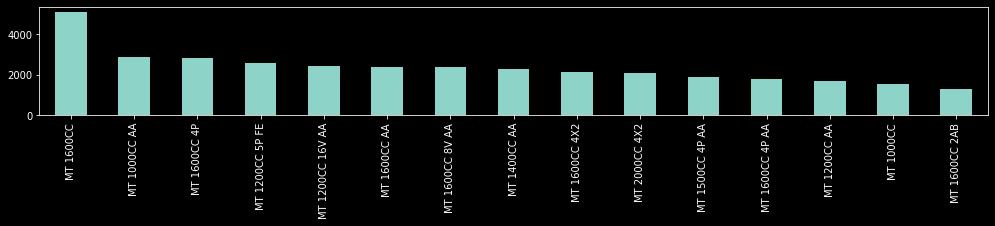

In [450]:
df['REF3'].value_counts()[:15].plot(figsize=(17,2), kind='bar')

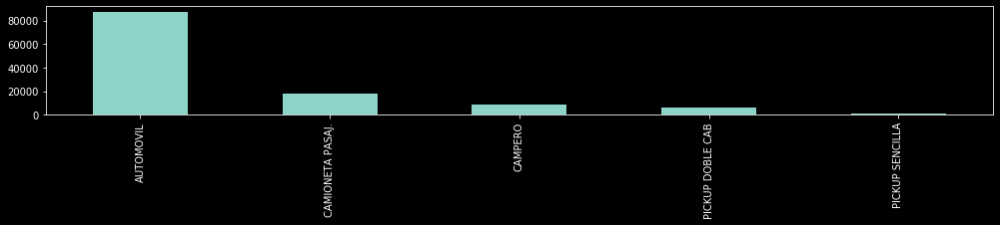

In [451]:
df['CLASE'].value_counts().plot(figsize=(17,2), kind='bar')

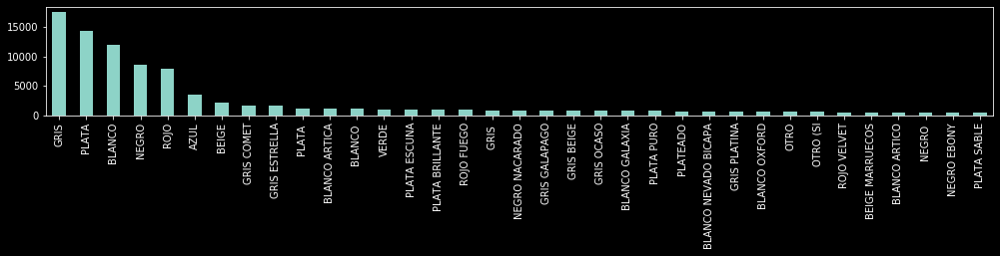

In [452]:
df['COLOR'].value_counts()[:35].plot(figsize=(17,2), kind='bar')

TO FIX: there are no governance in the color variable because exist multiples rows with the same value in different positions

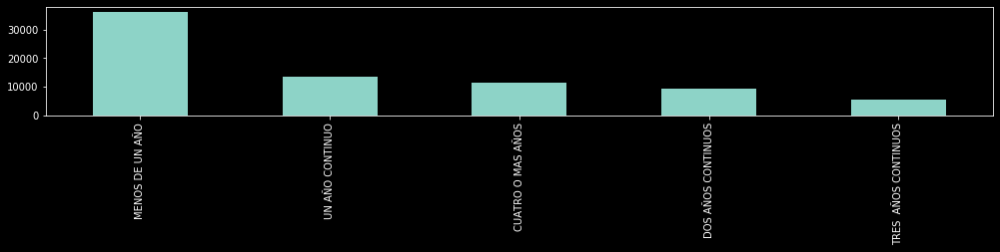

In [453]:
df['Años de no reclamación'].value_counts().plot(figsize=(17,2), kind='bar')


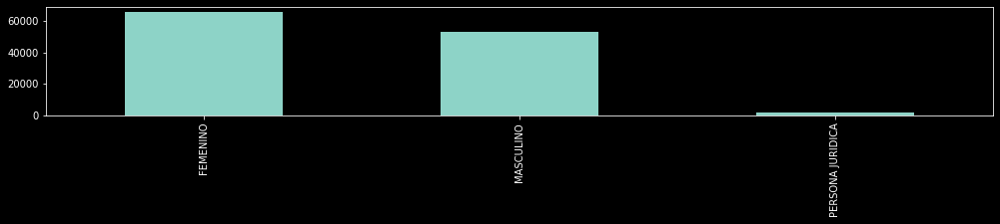

In [454]:
df['GENERO'].value_counts().plot(figsize=(17,2), kind='bar')

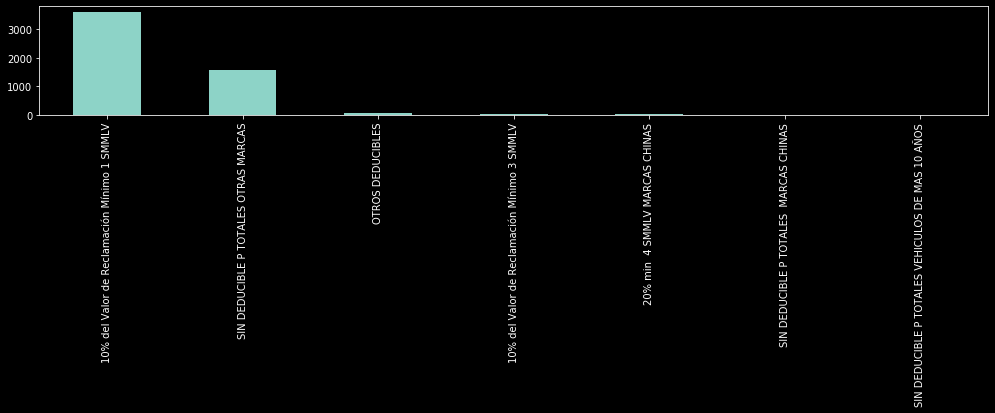

In [455]:
df['DEDUCIBLES'].value_counts().plot(figsize=(17,2), kind='bar')

Plotting Numerical data

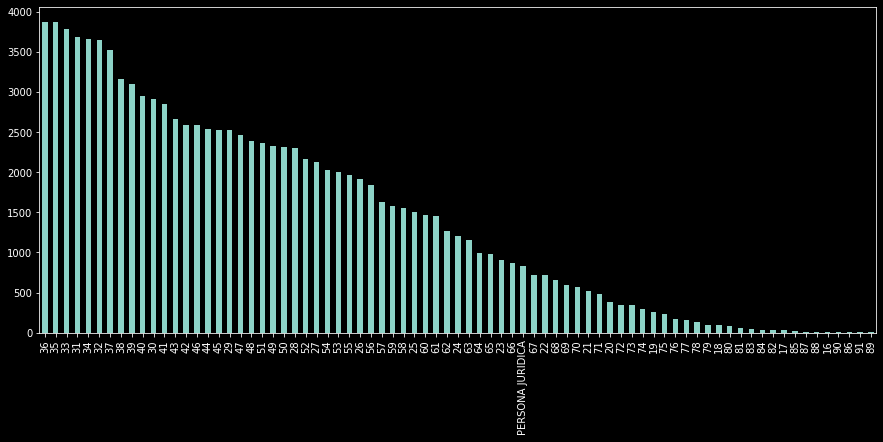

In [456]:
# let´s change the "EDAD" variable to numeric data

df['EDAD'].value_counts().plot(kind='bar', figsize=(15,6));

TO FIX: I need to delete "PERSONA JURIDICA" in this variable to change it to numeric data

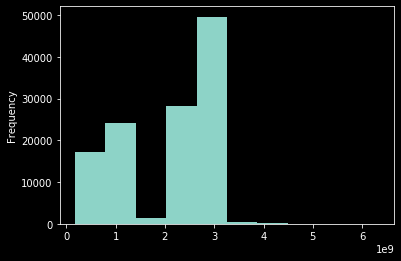

In [457]:
df['Valor Asegurado'].plot(kind='hist');

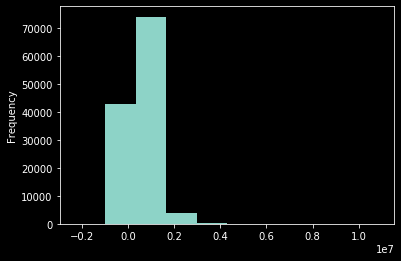

In [458]:
df['Valor prima Anual'].plot(kind='hist')

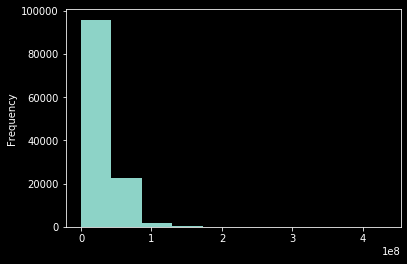

In [459]:
df['Valor asegurado Vhiculo'].plot(kind='hist')

Plotting categorica vs numerical

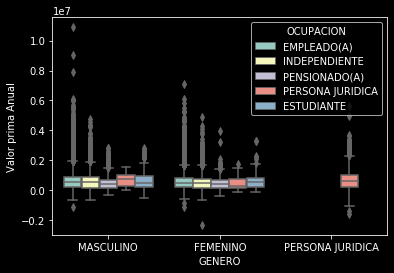

In [460]:
sns.boxplot(y="Valor prima Anual", x="GENERO", data=df, hue='OCUPACION');

TO FIX: With this information we could discuss about the 25th and 75th percentile are similar in the 3 Generos related with "valor prima anual". In the data cleanning section I´m going to delete thos values and put the mode and in the "EDAD" columns the Mode

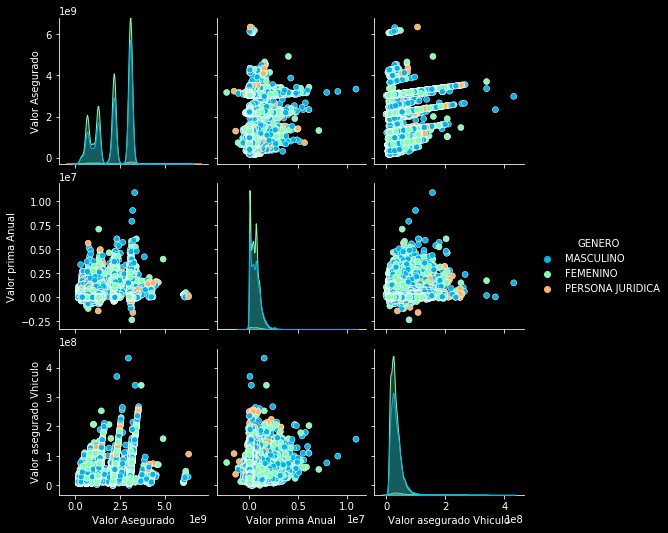

In [461]:
sns.pairplot(df, hue='GENERO', palette='rainbow');

There are some slightly positive correlation between "Valor prima anual" and "valor asegurado vehiculo"


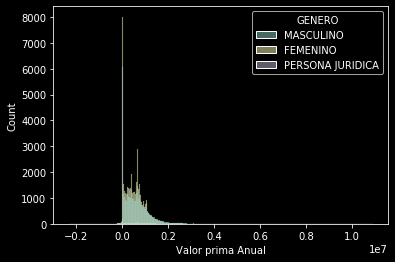

In [462]:
sns.histplot(data=df, x='Valor prima Anual', hue='GENERO')

TO FIX: there are some negative values in "valor prima anual"

In [463]:
px.histogram(df,'Valor prima Anual', nbins=10 )

TO FIX: there are some negative values in valor prima anual"

In [464]:
px.scatter(df,x='Valor prima Anual', y='DEDUCIBLES', color='GENERO', opacity=0.2)

In [465]:
px.scatter(df,x='Valor prima Anual', y='Valor asegurado Vhiculo', color='Tipo poliza', opacity=0.5)

most of the negative values came from the "modificación" -"tipo de poliza" category

In [466]:
px.scatter(df,x='Valor prima Anual', y='Valor Asegurado', color='Tipo poliza', opacity=0.5)

as the "valor asegurado" increades "valor prima anual" slight increase too

In [467]:
px.scatter(df,x='Valor prima Anual',y='Años de no reclamación',
          marginal_x='histogram',
          marginal_y='histogram')

Correlation matrix

In [468]:
df.corr()

,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo
Valor Asegurado,1.000000,-0.065339,0.117959
Valor prima Anual,-0.065339,1.000000,0.196321
Valor asegurado Vhiculo,0.117959,0.196321,1.000000


# 4. DATA CLEANING 

As we see in the statistical description, we need to handle with the "juridico" values that are in the EDAD column and other things to fix

# 4.1 OUTLIERS

In [469]:
df.describe()

,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo
count,1.208250e+05,1.208250e+05,1.208250e+05
mean,2.135436e+09,5.747100e+05,3.225057e+07
std,9.394923e+08,5.113818e+05,1.919327e+07
min,1.731979e+08,-2.331607e+06,2.880000e+04
25%,1.271879e+09,1.804621e+05,1.940000e+07
50%,2.172953e+09,5.068577e+05,2.799000e+07
75%,3.068639e+09,8.204400e+05,4.020000e+07
max,6.345327e+09,1.089682e+07,4.320000e+08


## EDAD

Let´s look for "PERSONA JURIDICA" value on edad variable, and delete those values, later I´ll fill it with the mode

In [470]:
import numpy as np

In [471]:
df.loc[df['EDAD'] == 'PERSONA JURIDICA', 'EDAD'] = np.nan

In [472]:
df.loc[df['EDAD'] == 'PERSONA JURIDICA', 'EDAD']

Series([], Name: EDAD, dtype: object)

## Valor Asegurado

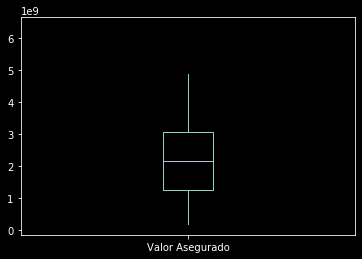

In [473]:
df['Valor Asegurado'].plot(kind='box')

## Valor prima Anual

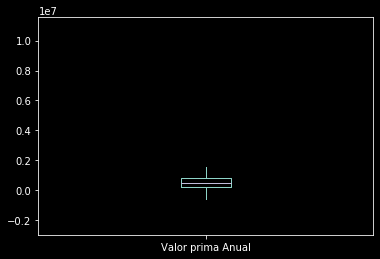

In [474]:
df['Valor prima Anual'].plot(kind='box')

In [475]:
df.loc[df['Valor prima Anual']<0, 'Valor prima Anual'] = df['Valor prima Anual'].mean() 

This negative value are the 0.8% of the dataset rows. I´m going to change for the mean value

In [476]:
df.describe()

,Valor Asegurado,Valor prima Anual,Valor asegurado Vhiculo
count,1.208250e+05,1.208250e+05,1.208250e+05
mean,2.135436e+09,5.802883e+05,3.225057e+07
std,9.394923e+08,5.074134e+05,1.919327e+07
min,1.731979e+08,0.000000e+00,2.880000e+04
25%,1.271879e+09,1.935761e+05,1.940000e+07
50%,2.172953e+09,5.182499e+05,2.799000e+07
75%,3.068639e+09,8.204400e+05,4.020000e+07
max,6.345327e+09,1.089682e+07,4.320000e+08


## Genero

In [477]:
df.loc[df['GENERO'] == 'PERSONA JURIDICA']
print('The % of the "persona juridica" inside GENERO variable is', len(df.loc[df['GENERO'] == 'PERSONA JURIDICA'])/len(df)*100, '%')

The % of the "persona juridica" inside GENERO variable is 1.5932133250569005 %


In [478]:
df.loc[df['GENERO'] == 'PERSONA JURIDICA', 'GENERO'] = df['GENERO'].mode()[0]

In [479]:
df['GENERO'].value_counts()

FEMENINO     67722
MASCULINO    53103
Name: GENERO, dtype: int64

## Valor asegurado Vhiculo

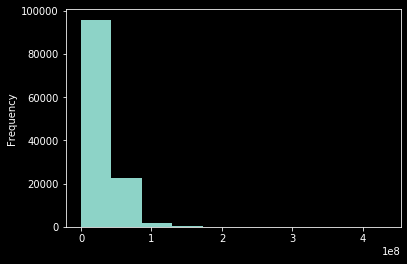

In [480]:
df['Valor asegurado Vhiculo'].plot(kind='hist')

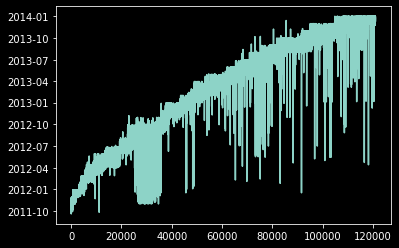

In [481]:
df['Fecha Inicio'].plot()

In [482]:
df.columns

Index(['Tipo poliza', 'Valor Asegurado', 'Fecha Emisión ', 'Fecha Inicio',
       'Fecha fin', 'Valor prima Anual', 'Valor asegurado Vhiculo', 'Ciudad',
       'DEPARTAMENTO', 'OCUPACION', 'EDAD', 'MARCA', 'REF1', 'REF2', 'REF3',
       'CLASE', 'Modelo del Vehiculo', 'COLOR', 'Años de no reclamación',
       'GENERO', 'DEDUCIBLES'],
      dtype='object')

In [483]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 120825 entries, 0 to 120929
Data columns (total 21 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   Tipo poliza              120825 non-null  object        
 1   Valor Asegurado          120825 non-null  int64         
 2   Fecha Emisión            120825 non-null  datetime64[ns]
 3   Fecha Inicio             120825 non-null  datetime64[ns]
 4   Fecha fin                120825 non-null  datetime64[ns]
 5   Valor prima Anual        120825 non-null  float64       
 6   Valor asegurado Vhiculo  120825 non-null  int64         
 7   Ciudad                   120535 non-null  object        
 8   DEPARTAMENTO             120522 non-null  object        
 9   OCUPACION                120825 non-null  object        
 10  EDAD                     108333 non-null  object        
 11  MARCA                    120825 non-null  object        
 12  REF1            

# 4.2 NULLS

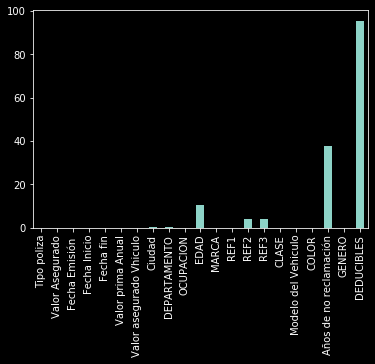

In [484]:
(df.isna().sum()/len(df)*100).plot(kind='bar')

## Deducibles

I´ve decided to drop "DEDUCIBLES" column due to the quantity of % the NA values

In [485]:
df.drop('DEDUCIBLES', axis=1, inplace=True)

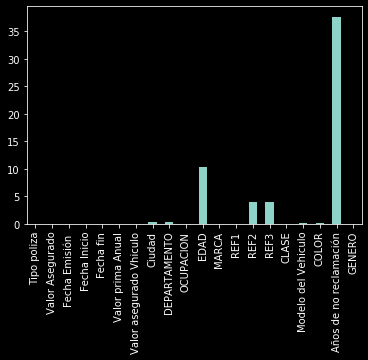

In [486]:
(df.isna().sum()/len(df)*100).plot(kind='bar')

## Años de reclamación

In [487]:
px.scatter(df,x='Valor prima Anual', y='Años de no reclamación', color='GENERO', opacity=0.5)

Let´s drop this column

In [488]:
df.drop('Años de no reclamación', axis=1, inplace=True)

## Modelo del Vehiculo 

In [489]:
df['Modelo del Vehiculo'].isna().sum()

128

In [490]:
df.loc[df['Modelo del Vehiculo'].isna(), 'Modelo del Vehiculo'] = df['Modelo del Vehiculo'].mode()[0] 

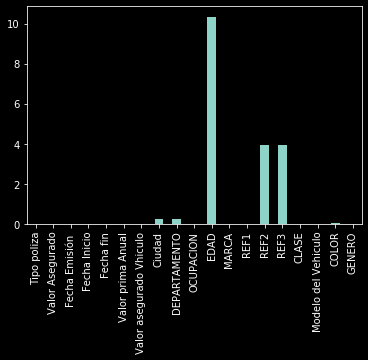

In [491]:
(df.isna().sum()/len(df)*100).plot(kind='bar');

## REF3

In [492]:
df.loc[df['REF3'].isna(), 'REF3'] = df['REF3'].mode()[0] 

## REF2

In [493]:
df.loc[df['REF2'].isna(), 'REF2'] = df['REF2'].mode()[0] 

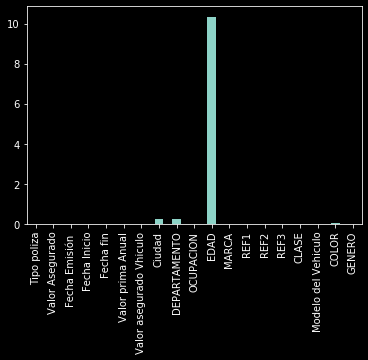

In [494]:
(df.isna().sum()/len(df)*100).plot(kind='bar');

## EDAD

Let´s fill the NA values with the mean()

In [495]:
df['EDAD'] = pd.to_numeric(df['EDAD'])

In [496]:
df.loc[df['EDAD'].isna(), 'EDAD'] = df['EDAD'].mean()

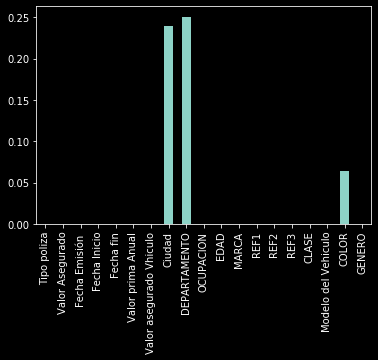

In [497]:
(df.isna().sum()/len(df)*100).plot(kind='bar');

## DEPARTAMENTO

In [498]:
df.columns

Index(['Tipo poliza', 'Valor Asegurado', 'Fecha Emisión ', 'Fecha Inicio',
       'Fecha fin', 'Valor prima Anual', 'Valor asegurado Vhiculo', 'Ciudad',
       'DEPARTAMENTO', 'OCUPACION', 'EDAD', 'MARCA', 'REF1', 'REF2', 'REF3',
       'CLASE', 'Modelo del Vehiculo', 'COLOR', 'GENERO'],
      dtype='object')

Let´s see how the behaviour of "DEPARTAMENTO" is with  "prima anual"

In [499]:
px.box(df,x = 'DEPARTAMENTO',y='Valor prima Anual')

I could fill NA values with the mode of the DEPARTAMENTO variable

In [500]:
df.loc[df['DEPARTAMENTO'].isna(), 'DEPARTAMENTO'] = df['DEPARTAMENTO'].mode()[0]

## CIUDAD

Let´s do the same as we did with DEPARTAMENTO variable filling NA values

In [501]:
px.box(df,x = 'Ciudad',y='Valor prima Anual')

In [502]:
df.loc[df['Ciudad'].isna(), 'Ciudad'] = df['Ciudad'].mode()[0]

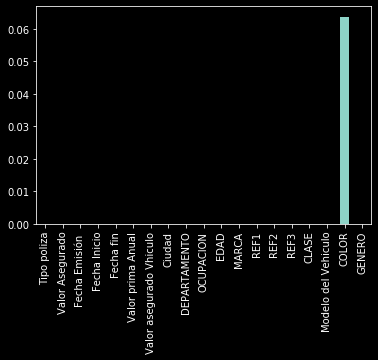

In [503]:
(df.isna().sum()/len(df)*100).plot(kind='bar');

## COLOR

In [504]:
df.loc[df['COLOR'].isna(), 'COLOR'] = df['COLOR'].mode()[0]

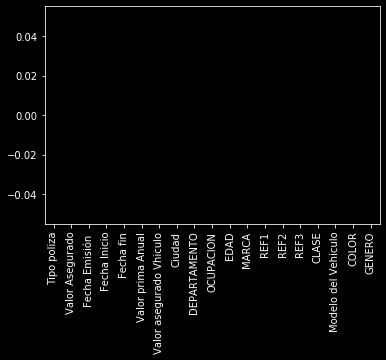

In [505]:
(df.isna().sum()/len(df)*100).plot(kind='bar');

## MARCA/TIPO (CODIGO FASECOLDA)

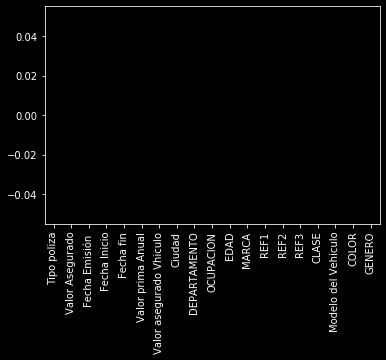

In [507]:
(df.isna().sum()/len(df)*100).plot(kind='bar');

Finally I have all dataset cleaned

In [508]:
df.isna().sum()

Tipo poliza                0
Valor Asegurado            0
Fecha Emisión              0
Fecha Inicio               0
Fecha fin                  0
Valor prima Anual          0
Valor asegurado Vhiculo    0
Ciudad                     0
DEPARTAMENTO               0
OCUPACION                  0
EDAD                       0
MARCA                      0
REF1                       0
REF2                       0
REF3                       0
CLASE                      0
Modelo del Vehiculo        0
COLOR                      0
GENERO                     0
dtype: int64

Check of a duplicated rows again

In [509]:
df.duplicated().sum()

3

In [510]:
df.drop_duplicates(keep='first', inplace=True)

In [511]:
df.duplicated().sum()

0

In [512]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 120822 entries, 0 to 120929
Data columns (total 19 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   Tipo poliza              120822 non-null  object        
 1   Valor Asegurado          120822 non-null  int64         
 2   Fecha Emisión            120822 non-null  datetime64[ns]
 3   Fecha Inicio             120822 non-null  datetime64[ns]
 4   Fecha fin                120822 non-null  datetime64[ns]
 5   Valor prima Anual        120822 non-null  float64       
 6   Valor asegurado Vhiculo  120822 non-null  int64         
 7   Ciudad                   120822 non-null  object        
 8   DEPARTAMENTO             120822 non-null  object        
 9   OCUPACION                120822 non-null  object        
 10  EDAD                     120822 non-null  float64       
 11  MARCA                    120822 non-null  object        
 12  REF1            

## DataBase Cleaned and conclusions
1. I reduced the DB from 23 to 20 variables
2. I reduced the rows from 120930 to 120882
3. The memory usage of the dataset was reduced on 12%
4. I´m going to work with this DB and make some models, even without creating new variables. Depending on the behaviour of the models I´ll take this DB and do some feature engineering

In [513]:
df.head(3)

,Tipo poliza,Valor Asegurado,Fecha Emisión,Fecha Inicio,Fecha fin,Valor prima Anual,Valor asegurado Vhiculo,Ciudad,DEPARTAMENTO,OCUPACION,EDAD,MARCA,REF1,REF2,REF3,CLASE,Modelo del Vehiculo,COLOR,GENERO
0,Renovacion,684689000,2011-10-10,2011-11-21,2012-11-21,782949.0,18800000,CARTAGENA,BOLIVAR,EMPLEADO(A),45.0,CHEVROLET,AVEO,FAMILY,MT 1500CC 4P AA,AUTOMOVIL,2010.0,NEGRO EBONY,MASCULINO
1,Nuevo,965205600,2011-10-10,2011-10-05,2012-10-05,715824.0,24900000,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),41.0,CHEVROLET,AVEO EMOTION,1.6L,MT 1600CC AA 2AB ABS,AUTOMOVIL,2009.0,BLANCO ARCO BICAPA,MASCULINO
2,Nuevo,640605600,2011-10-10,2011-10-03,2012-10-03,740816.0,12600000,MEDELLIN,ANTIOQUIA,INDEPENDIENTE,33.0,RENAULT,CLIO II,F.II EXPRESSION,MT 1400CC PACK,AUTOMOVIL,2002.0,BEIGE CARRARA,FEMENINO


In [514]:
df.columns

Index(['Tipo poliza', 'Valor Asegurado', 'Fecha Emisión ', 'Fecha Inicio',
       'Fecha fin', 'Valor prima Anual', 'Valor asegurado Vhiculo', 'Ciudad',
       'DEPARTAMENTO', 'OCUPACION', 'EDAD', 'MARCA', 'REF1', 'REF2', 'REF3',
       'CLASE', 'Modelo del Vehiculo', 'COLOR', 'GENERO'],
      dtype='object')

# Rename Columns

In [515]:
df.rename(columns = {'Tipo poliza':'Tipo_poliza','Valor Asegurado':'Valor_Asegurado', 'Fecha Emisión ':'Fecha_Emisión',
                       'Fecha Inicio':'Fecha_Inicio', 'Fecha fin':'Fecha_fin', 'Valor prima Anual':'Valor_prima_Anual',
                        'Valor asegurado Vhiculo': 'Valor_asegurado_Vehiculo',
                        'Modelo del Vehiculo': 'Modelo_del_Vehiculo',}, 
                        inplace=True)

In [516]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 120822 entries, 0 to 120929
Data columns (total 19 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   Tipo_poliza               120822 non-null  object        
 1   Valor_Asegurado           120822 non-null  int64         
 2   Fecha_Emisión             120822 non-null  datetime64[ns]
 3   Fecha_Inicio              120822 non-null  datetime64[ns]
 4   Fecha_fin                 120822 non-null  datetime64[ns]
 5   Valor_prima_Anual         120822 non-null  float64       
 6   Valor_asegurado_Vehiculo  120822 non-null  int64         
 7   Ciudad                    120822 non-null  object        
 8   DEPARTAMENTO              120822 non-null  object        
 9   OCUPACION                 120822 non-null  object        
 10  EDAD                      120822 non-null  float64       
 11  MARCA                     120822 non-null  object        
 12  RE

## Save as CSV cleaned DataSet

In [517]:
df.to_csv('DB_Valor_Prima_Anual_Cleaned.csv', index=False)

# FEATURING ENGINEERING (ANTIGUEDAD)

In [526]:
df['ANTIGUEDAD'] =  df['Fecha_fin'] - df['Fecha_Inicio']


In [532]:
df['ANTIGUEDAD'] = df['ANTIGUEDAD'].dt.days

In [533]:
df.head(2)

,Tipo_poliza,Valor_Asegurado,Fecha_Emisión,Fecha_Inicio,Fecha_fin,Valor_prima_Anual,Valor_asegurado_Vehiculo,Ciudad,DEPARTAMENTO,OCUPACION,EDAD,MARCA,REF1,REF2,REF3,CLASE,Modelo_del_Vehiculo,COLOR,GENERO,ANTIGUEDAD
0,Renovacion,684689000,2011-10-10,2011-11-21,2012-11-21,782949.0,18800000,CARTAGENA,BOLIVAR,EMPLEADO(A),45.0,CHEVROLET,AVEO,FAMILY,MT 1500CC 4P AA,AUTOMOVIL,2010.0,NEGRO EBONY,MASCULINO,366
1,Nuevo,965205600,2011-10-10,2011-10-05,2012-10-05,715824.0,24900000,BOGOTA D.C.,CUNDINAMARCA,EMPLEADO(A),41.0,CHEVROLET,AVEO EMOTION,1.6L,MT 1600CC AA 2AB ABS,AUTOMOVIL,2009.0,BLANCO ARCO BICAPA,MASCULINO,366


In [534]:
df.to_csv('DB_Valor_Prima_Anual_Cleaned_antiguedadCol.csv', index=False)